# Stay Point Analysis

In [1]:
# Basic
import numpy as np
import pandas as pd
import geopandas as gpd

# Map
from shapely import wkt 
import osmnx as ox

# Visualizations
import matplotlib.pyplot as plt 

In [100]:
# Import data
stps = pd.read_csv('../../trackintel/20190601_stps.csv')
stps['geom'] = stps['geom'].apply(wkt.loads)
stps = gpd.GeoDataFrame(stps.rename(columns={'geom':'geometry'}))

# Label data
amen = pd.read_csv('../data/amenity.csv')
build = pd.read_csv('../data/building.csv')

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [3]:
# Specify the name that is used to search for the data
place_name = 'Shinjuku, Tokyo, Japan'

# Fetch OSM street network from the location
area = ox.geocode_to_gdf(place_name)

In [101]:
# Limit stay points for Shinjuku-ku only
shinjuku_mask = stps['geometry'].map(lambda x: x.within(area['geometry'].values[0]))
stps = stps[shinjuku_mask]

In [5]:
# Fetch OSM street network from the location
graph = ox.graph_from_place(place_name)

# Retrive nodes and edges 
nodes, edges = ox.graph_to_gdfs(graph)

In [6]:
# Get POI
amenities = ox.geometries_from_place(place_name, {'amenity': list(amen.Value.values)})
building = ox.geometries_from_place(place_name, {'building': list(build.Value.values)})
parks = ox.geometries_from_place(place_name, {'leisure': 'park', 'landuse': 'grass'})

print('amenities: {}, buildings: {}, parks: {}'.format(len(amenities), len(building), len(parks)))

amenities: 5167, buildings: 734, parks: 257


/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


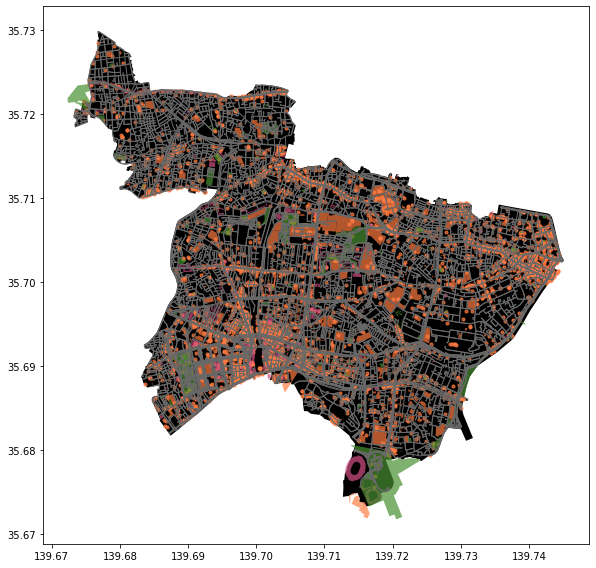

In [10]:
fig, ax = plt.subplots(figsize=(12,8))

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot: street edge
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

# Plot: amenities
amenities.plot(ax=ax, color='#ff7c43', facecolor='#ff7c43', alpha=0.7, markersize=10)

# Plot: building
building.plot(ax=ax, color='#d45087', facecolor='#d45087', alpha=0.7, markersize=10)

# Plot: parks
parks.plot(ax=ax, color='#488f31', facecolor='#488f31', alpha=0.7, markersize=10)

plt.tight_layout()

## Getting a more detailed plot

In [7]:
amenities['label'] = amenities['amenity'].map(dict(zip(amen.Value, amen.Element)))
building['label'] = building['building'].map(dict(zip(build.Value, build.Element)))

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [8]:
amenitites = amenities.loc[:,['geometry', 'amenity', 'label']]
building = building.loc[:,['geometry', 'building', 'label']]

### Amenities

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


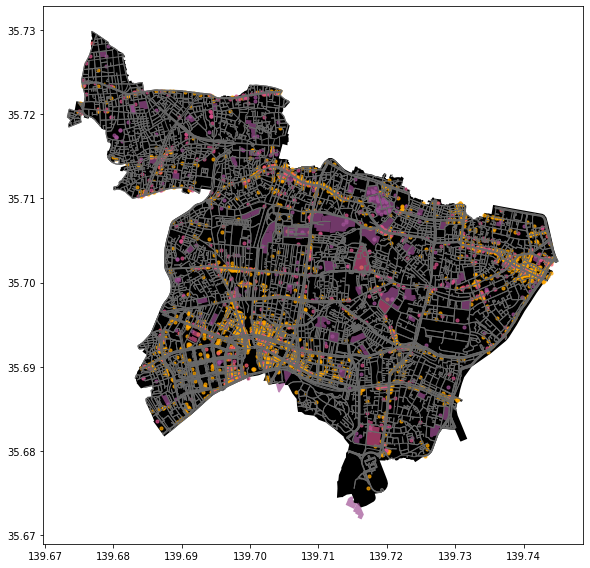

In [25]:
fig, ax = plt.subplots(figsize=(12,8))

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot: street edge
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

# Plot: food
amenities[amenities['label'] == 'food'].plot(ax=ax, color='#ffa600', facecolor='#ffa600', alpha=0.7, markersize=10)

# Plot: finance
amenities[amenities['label'] == 'finance'].plot(ax=ax, color='#f95d6a', facecolor='#f95d6a', alpha=0.7, markersize=10)

# Plot: education
amenities[amenities['label'] == 'education'].plot(ax=ax, color='#a05195', facecolor='#a05195', alpha=0.7, markersize=10)

# Plot: healthcare
amenities[amenities['label'] == 'healthcare'].plot(ax=ax, color='#d45087', facecolor='#d45087', alpha=0.7, markersize=10)

plt.tight_layout()

## Plot Stay Points

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


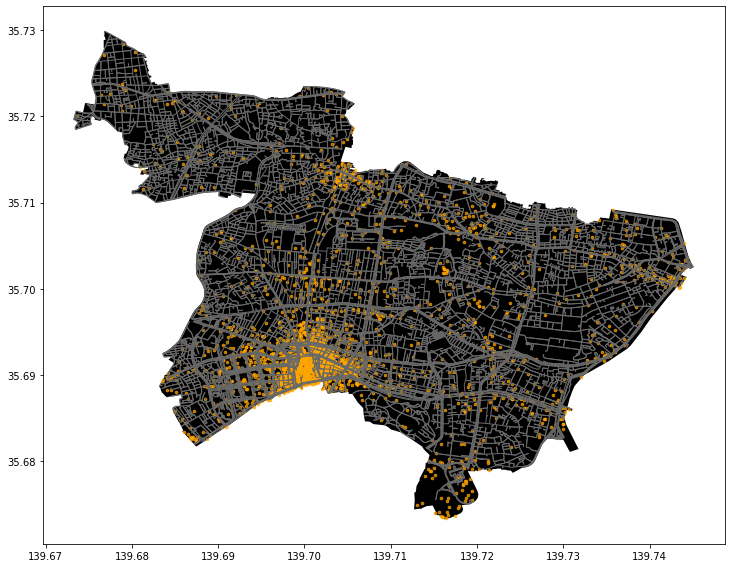

In [37]:
fig, ax = plt.subplots(figsize=(12,8))

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot: street edge
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

# Plot: food
# amenities[amenities['label'] == 'food'].plot(ax=ax, color='#ffa600', facecolor='#ffa600', alpha=0.7, markersize=10)

# Plot: finance
# amenities[amenities['label'] == 'finance'].plot(ax=ax, color='#f95d6a', facecolor='#f95d6a', alpha=0.7, markersize=10)
 
# Plot: education
# amenities[amenities['label'] == 'education'].plot(ax=ax, color='#a05195', facecolor='#a05195', alpha=0.7, markersize=10)

# Plot: healthcare
# amenities[amenities['label'] == 'healthcare'].plot(ax=ax, color='#d45087', facecolor='#d45087', alpha=0.7, markersize=10)

stps.plot(ax=ax, color='#ffa600', alpha=0.7, markersize=7)

plt.tight_layout()

In [49]:
from sklearn.neighbors import BallTree

def get_nearest(src_points, candidates, k_neighbors=1):
    """Find nearest neighbors for all source points from a set of candidate points"""

    # Create tree from the candidate points
    tree = BallTree(candidates, leaf_size=15, metric='haversine')

    # Find closest points and distances
    distances, indices = tree.query(src_points, k=k_neighbors)

    # Transpose to get distances and indices into arrays
    distances = distances.transpose()
    indices = indices.transpose()

    # Get closest indices and distances (i.e. array at index 0)
    # note: for the second closest points, you would take index 1, etc.
    closest = indices[0]
    closest_dist = distances[0]

    # Return indices and distances
    return (closest, closest_dist)


def nearest_neighbor(left_gdf, right_gdf, return_dist=False):
    """
    For each point in left_gdf, find closest point in right GeoDataFrame and return them.

    NOTICE: Assumes that the input Points are in WGS84 projection (lat/lon).
    """

    left_geom_col = left_gdf.geometry.name
    right_geom_col = right_gdf.geometry.name

    # Ensure that index in right gdf is formed of sequential numbers
    right = right_gdf.copy().reset_index(drop=True)

    # Parse coordinates from points and insert them into a numpy array as RADIANS
    left_radians = np.array(left_gdf[left_geom_col].apply(lambda geom: (geom.x * np.pi / 180, geom.y * np.pi / 180)).to_list())
    right_radians = np.array(right[right_geom_col].apply(lambda geom: (geom.x * np.pi / 180, geom.y * np.pi / 180)).to_list())

    # Find the nearest points
    # -----------------------
    # closest ==> index in right_gdf that corresponds to the closest point
    # dist ==> distance between the nearest neighbors (in meters)

    closest, dist = get_nearest(src_points=left_radians, candidates=right_radians)

    # Return points from right GeoDataFrame that are closest to points in left GeoDataFrame
    closest_points = right.loc[closest]

    # Ensure that the index corresponds the one in left_gdf
    closest_points = closest_points.reset_index(drop=True)

    # Add distance if requested
    if return_dist:
        # Convert to meters from radians
        earth_radius = 6371000  # meters
        closest_points['distance'] = dist * earth_radius

    return closest_points

In [56]:
amenities = amenities.rename(columns={'amenity': 'poi'})
building = building.rename(columns={'building': 'poi'})
poi = pd.concat([amenities, building]).loc[:,['osmid', 'geometry', 'poi', 'label']]
type(poi)

geopandas.geodataframe.GeoDataFrame

In [38]:
from shapely.geometry import Point, Polygon, MultiPolygon

mask_polygon = [isinstance(geom, Polygon) for geom in poi.geometry.values]

def flatten_polygon(row):
    pts = [Point(coord) for coord in list(row.geometry.exterior.coords)]
    df = pd.DataFrame({'geometry': pts})
    for col in row.index:
        if col != 'geometry':
            df[col] = row[col]
    return gpd.GeoDataFrame(df)

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [57]:
mask_point = [isinstance(geom, Point) for geom in poi.geometry.values]
poi_subset = poi[mask_point]
flat = pd.concat([flatten_polygon(r) for i, r in poi[mask_polygon].iterrows()])
poi = pd.concat([poi_subset, flat])

In [97]:
# Find closest POI
closest_poi = nearest_neighbor(stps, poi, return_dist=True)

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [98]:
# Check Results
closest_poi.head()

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,osmid,geometry,poi,label,distance
0,2.188450e+09,POINT (139.69803 35.68838),telephone,others,18.295541
1,2.319502e+09,POINT (139.69772 35.68884),restaurant,food,3.568997
2,5.038407e+09,POINT (139.71589 35.69186),restaurant,food,11.921145
3,1.143722e+09,POINT (139.70610 35.71347),restaurant,food,28.140519
4,5.036007e+09,POINT (139.71574 35.70970),restaurant,food,49.505126


In [65]:
# Basic descriptive analysis
closest_poi['distance'].describe()

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


count    2882.000000
mean       22.155728
std        19.227314
min         0.072633
25%         9.537937
50%        16.609492
75%        28.038303
max       150.442246
Name: distance, dtype: float64

In [102]:
## Combining the neighboring datasets 
# Rename
closest_poi = closest_poi.rename(columns={'geometry': 'closest_poi_geom'})

# Merge the datasets by index
stps = pd.concat([stps.reset_index(drop=True), closest_poi.reset_index(drop=True)], axis=1)

# Check
stps.head()

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,started_at,finished_at,geometry,id,user_id,osmid,closest_poi_geom,poi,label,distance
0,2019-06-01 16:15:00,2019-06-01 16:42:00,POINT (139.69810 35.68818),2,cf0e2a9dc9eec94d1be9a77a0f7fd07ad67095243cfbfe...,2.188450e+09,POINT (139.69803 35.68838),telephone,others,18.295541
1,2019-06-01 12:51:00,2019-06-01 13:31:00,POINT (139.69775 35.68883),17,2eeaa38c48d148850ce2cd4ad7ae258c90e47d1f5309e2...,2.319502e+09,POINT (139.69772 35.68884),restaurant,food,3.568997
2,2019-06-01 10:22:00,2019-06-01 12:10:00,POINT (139.71599 35.69192),92,6cac2227f601603ce05f062df4449d0bacc64cd419caba...,5.038407e+09,POINT (139.71589 35.69186),restaurant,food,11.921145
3,2019-06-01 20:15:00,2019-06-01 23:34:00,POINT (139.70585 35.71342),101,96d3363895c069c69d7946996fd273239bc4f94f41c6db...,1.143722e+09,POINT (139.70610 35.71347),restaurant,food,28.140519
4,2019-06-01 10:51:00,2019-06-01 14:09:00,POINT (139.71544 35.71013),240,989b02bb6c842712ccd15de558f057ebc4045717634f06...,5.036007e+09,POINT (139.71574 35.70970),restaurant,food,49.505126


/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

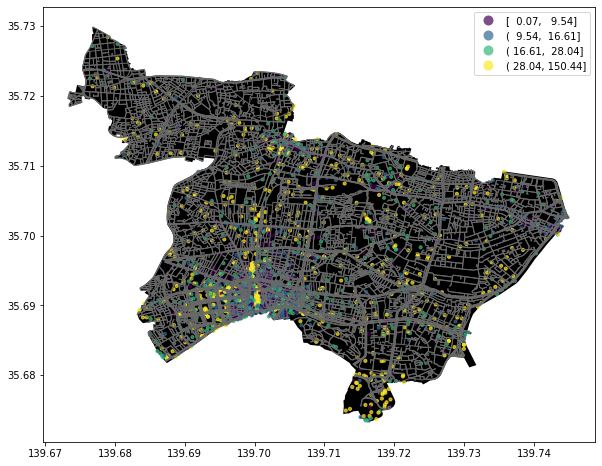

In [103]:
fig, ax = plt.subplots(figsize=(12,8))

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot: street edge
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

# Stay points
stps.plot(ax=ax, column='distance', markersize=10, alpha=0.7, scheme='quantiles', k=4, legend=True)

In [106]:
from shapely.geometry import LineString

# Create a link (LineString) between building and stop points
stps['link'] = stps.apply(lambda row: LineString([row['geometry'], row['closest_poi_geom']]), axis=1)

# Set link as the active geometry
stps_links = stps.copy()
stps_links = stps_links.set_geometry('link')

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


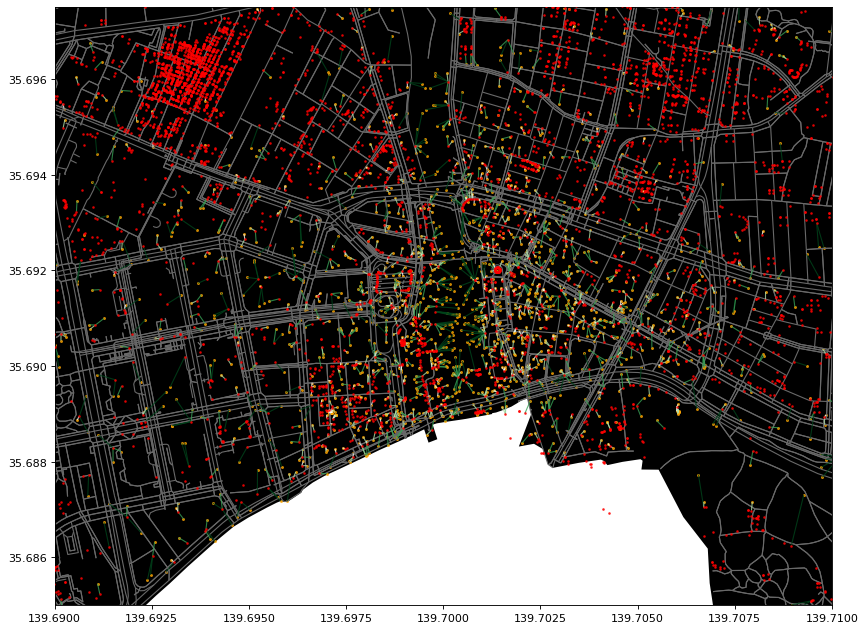

In [116]:
# Plot the connecting links between buildings and stops and color them based on distance
fig, ax = plt.subplots(figsize=(12,8), dpi=80)

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot: street edge
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

stps_links.plot(ax=ax, column='distance', cmap='Greens', scheme='quantiles', k=4, alpha=0.8, lw=1, figsize=(13, 10))
stps.plot(ax=ax, color='#ffa600', markersize=3, alpha=0.7)
poi.plot(ax=ax, markersize=2, marker='o', color='red', alpha=0.7, zorder=3)

# Zoom closer
ax.set_xlim([139.69, 139.71])
ax.set_ylim([35.6850, 35.6975])

plt.tight_layout()

In [140]:
stps['started_at'] = pd.to_datetime(stps['started_at'])
stps['finished_at'] = pd.to_datetime(stps['finished_at'])

stps_df = pd.DataFrame(stps.copy())
type(stps_df)

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


pandas.core.frame.DataFrame

In [141]:
# Count each label
stps_df.groupby('label').count()['poi']

label
education         173
entertainment     101
finance            73
food              867
healthcare        133
home               65
hotel              24
others            469
religious           1
shopping          412
sports             22
transportation    501
work               41
Name: poi, dtype: int64

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:xlabel='started_at', ylabel='Count'>

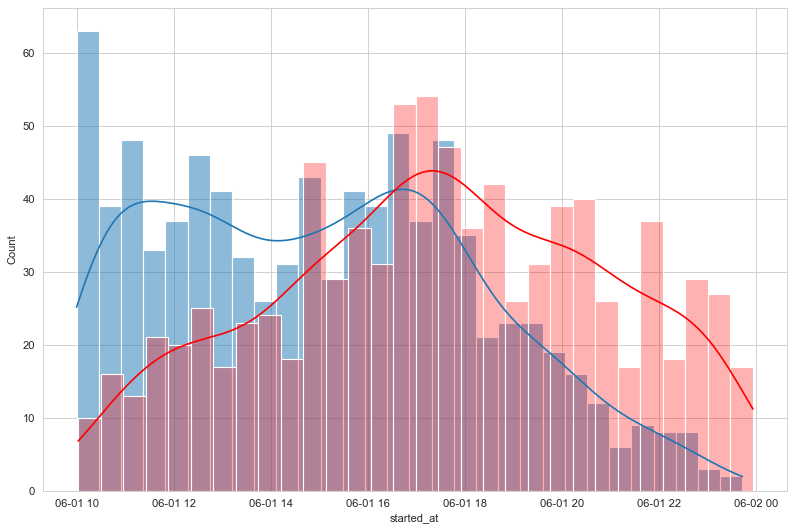

In [152]:
import seaborn as sns; sns.set_style('whitegrid')

fig, ax = plt.subplots(figsize=(12,8), dpi=80)

# Check the staring time for food
stps_food = stps_df[stsp_df['label'] == 'food']

# Visualize the distribution
sns.histplot(ax=ax, x='started_at', data = stps_food, bins=30, kde=True)
sns.histplot(ax=ax, x='finished_at', data = stps_food, bins=30, kde=True, color='red', alpha = 0.3)

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-154-8f1343b0a6d7>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stps_food['duration'] = stps_food['finished_at'] - stps_food['started_at']
<ipython-input-154-8f1343b0a6d7>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


<AxesSubplot:xlabel='duration', ylabel='Count'>

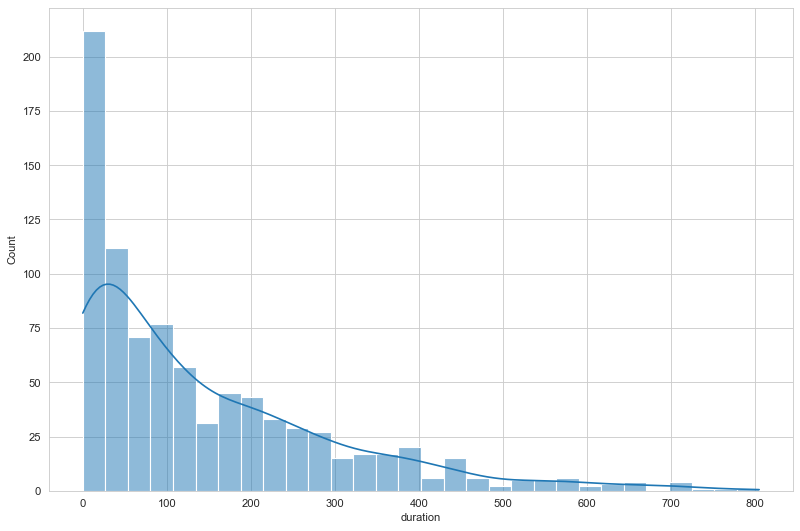

In [154]:
# How long did the breakfast/lunch/dinner last?
fig, ax = plt.subplots(figsize=(12,8), dpi=80)

stps_food['duration'] = stps_food['finished_at'] - stps_food['started_at']
stps_food['duration'] = stps_food['duration'].map(lambda x: x.seconds/60)

sns.histplot(ax=ax, x='duration', data = stps_food, bins=30, kde=True)